In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn import linear_model
import joblib
import warnings

warnings.filterwarnings('ignore')

In [3]:
df = pd.read_csv("Datasets/solarpowergeneration.csv")
df

,temperature_2_m_above_gnd,relative_humidity_2_m_above_gnd,mean_sea_level_pressure_MSL,total_precipitation_sfc,snowfall_amount_sfc,total_cloud_cover_sfc,high_cloud_cover_high_cld_lay,medium_cloud_cover_mid_cld_lay,low_cloud_cover_low_cld_lay,shortwave_radiation_backwards_sfc,...,wind_direction_10_m_above_gnd,wind_speed_80_m_above_gnd,wind_direction_80_m_above_gnd,wind_speed_900_mb,wind_direction_900_mb,wind_gust_10_m_above_gnd,angle_of_incidence,zenith,azimuth,generated_power_kw
0,2.17,31,1035.0,0.0,0.0,0.0,0,0,0,0.00,...,312.71,9.36,22.62,6.62,337.62,24.48,58.753108,83.237322,128.33543,454.100950
1,2.31,27,1035.1,0.0,0.0,0.0,0,0,0,1.78,...,294.78,5.99,32.74,4.61,321.34,21.96,45.408585,75.143041,139.65530,1411.999400
2,3.65,33,1035.4,0.0,0.0,0.0,0,0,0,108.58,...,270.00,3.89,56.31,3.76,286.70,14.04,32.848282,68.820648,152.53769,2214.849300
3,5.82,30,1035.4,0.0,0.0,0.0,0,0,0,258.10,...,323.13,3.55,23.96,3.08,339.44,19.80,22.699288,64.883536,166.90159,2527.609200
4,7.73,27,1034.4,0.0,0.0,0.0,0,0,0,375.58,...,10.01,6.76,25.20,6.62,22.38,16.56,19.199908,63.795208,182.13526,2640.203400
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4208,8.69,66,1025.1,0.0,0.0,100.0,100,100,100,257.21,...,285.42,25.50,283.06,24.01,282.99,25.20,22.700907,64.952098,167.06794,173.410560
4209,7.57,90,1026.1,0.0,0.0,100.0,79,100,100,210.04,...,6.91,13.00,4.76,11.61,7.13,10.44,19.307487,63.895118,182.28247,403.792220
4210,7.27,90,1026.3,0.1,0.0,100.0,73,100,100,113.92,...,2.29,8.71,352.87,7.95,354.81,22.32,25.249506,65.827032,197.33868,158.367780
4211,8.25,81,1025.5,0.0,0.0,100.0,74,66,100,186.90,...,11.31,6.29,13.24,5.94,14.04,15.48,36.361161,70.496313,211.30027,126.953060


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4213 entries, 0 to 4212
Data columns (total 21 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   temperature_2_m_above_gnd          4213 non-null   float64
 1   relative_humidity_2_m_above_gnd    4213 non-null   int64  
 2   mean_sea_level_pressure_MSL        4213 non-null   float64
 3   total_precipitation_sfc            4213 non-null   float64
 4   snowfall_amount_sfc                4213 non-null   float64
 5   total_cloud_cover_sfc              4213 non-null   float64
 6   high_cloud_cover_high_cld_lay      4213 non-null   int64  
 7   medium_cloud_cover_mid_cld_lay     4213 non-null   int64  
 8   low_cloud_cover_low_cld_lay        4213 non-null   int64  
 9   shortwave_radiation_backwards_sfc  4213 non-null   float64
 10  wind_speed_10_m_above_gnd          4213 non-null   float64
 11  wind_direction_10_m_above_gnd      4213 non-null   float

In [5]:
df.describe

<bound method NDFrame.describe of       temperature_2_m_above_gnd  relative_humidity_2_m_above_gnd  \
0                          2.17                               31   
1                          2.31                               27   
2                          3.65                               33   
3                          5.82                               30   
4                          7.73                               27   
...                         ...                              ...   
4208                       8.69                               66   
4209                       7.57                               90   
4210                       7.27                               90   
4211                       8.25                               81   
4212                       8.00                               80   

      mean_sea_level_pressure_MSL  total_precipitation_sfc  \
0                          1035.0                      0.0   
1                        

In [6]:
df.describe()

,temperature_2_m_above_gnd,relative_humidity_2_m_above_gnd,mean_sea_level_pressure_MSL,total_precipitation_sfc,snowfall_amount_sfc,total_cloud_cover_sfc,high_cloud_cover_high_cld_lay,medium_cloud_cover_mid_cld_lay,low_cloud_cover_low_cld_lay,shortwave_radiation_backwards_sfc,...,wind_direction_10_m_above_gnd,wind_speed_80_m_above_gnd,wind_direction_80_m_above_gnd,wind_speed_900_mb,wind_direction_900_mb,wind_gust_10_m_above_gnd,angle_of_incidence,zenith,azimuth,generated_power_kw
count,4213.000000,4213.000000,4213.000000,4213.000000,4213.000000,4213.000000,4213.000000,4213.000000,4213.000000,4213.000000,...,4213.000000,4213.000000,4213.000000,4213.00000,4213.000000,4213.000000,4213.000000,4213.000000,4213.000000,4213.000000
mean,15.068111,51.361025,1019.337812,0.031759,0.002808,34.056990,14.458818,20.023499,21.373368,387.759036,...,195.078452,18.978483,191.166862,16.36319,192.447911,20.583489,50.837490,59.980947,169.167651,1134.347313
std,8.853677,23.525864,7.022867,0.170212,0.038015,42.843638,30.711707,36.387948,38.013885,278.459293,...,106.626782,11.999960,108.760021,9.88533,106.516195,12.648899,26.638965,19.857711,64.568385,937.957247
min,-5.350000,7.000000,997.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.540000,0.000000,1.120000,0.00000,1.120000,0.720000,3.755323,17.727761,54.379093,0.000595
25%,8.390000,32.000000,1014.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,142.400000,...,153.190000,10.140000,130.240000,9.18000,148.220000,11.160000,29.408181,45.291631,114.136600,231.700450
50%,14.750000,48.000000,1018.100000,0.000000,0.000000,8.700000,0.000000,0.000000,0.000000,381.810000,...,191.770000,16.240000,187.770000,14.49000,187.990000,18.000000,47.335557,62.142611,163.241650,971.642650
75%,21.290000,70.000000,1023.600000,0.000000,0.000000,100.000000,9.000000,10.000000,10.000000,599.860000,...,292.070000,26.140000,292.040000,21.97000,288.000000,27.000000,69.197492,74.346737,225.085620,2020.966700
max,34.900000,100.000000,1046.800000,3.200000,1.680000,100.000000,100.000000,100.000000,100.000000,952.300000,...,360.000000,66.880000,360.000000,61.11000,360.000000,84.960000,121.635920,128.415370,289.045180,3056.794100


In [7]:
df.isnull()

,temperature_2_m_above_gnd,relative_humidity_2_m_above_gnd,mean_sea_level_pressure_MSL,total_precipitation_sfc,snowfall_amount_sfc,total_cloud_cover_sfc,high_cloud_cover_high_cld_lay,medium_cloud_cover_mid_cld_lay,low_cloud_cover_low_cld_lay,shortwave_radiation_backwards_sfc,...,wind_direction_10_m_above_gnd,wind_speed_80_m_above_gnd,wind_direction_80_m_above_gnd,wind_speed_900_mb,wind_direction_900_mb,wind_gust_10_m_above_gnd,angle_of_incidence,zenith,azimuth,generated_power_kw
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4208,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4209,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4210,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4211,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [8]:
df.isnull().sum()

temperature_2_m_above_gnd            0
relative_humidity_2_m_above_gnd      0
mean_sea_level_pressure_MSL          0
total_precipitation_sfc              0
snowfall_amount_sfc                  0
total_cloud_cover_sfc                0
high_cloud_cover_high_cld_lay        0
medium_cloud_cover_mid_cld_lay       0
low_cloud_cover_low_cld_lay          0
shortwave_radiation_backwards_sfc    0
wind_speed_10_m_above_gnd            0
wind_direction_10_m_above_gnd        0
wind_speed_80_m_above_gnd            0
wind_direction_80_m_above_gnd        0
wind_speed_900_mb                    0
wind_direction_900_mb                0
wind_gust_10_m_above_gnd             0
angle_of_incidence                   0
zenith                               0
azimuth                              0
generated_power_kw                   0
dtype: int64

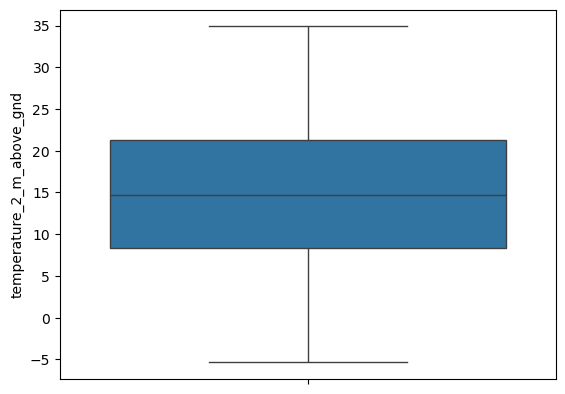

In [37]:
sns.boxplot(df['temperature_2_m_above_gnd'])
plt.show()

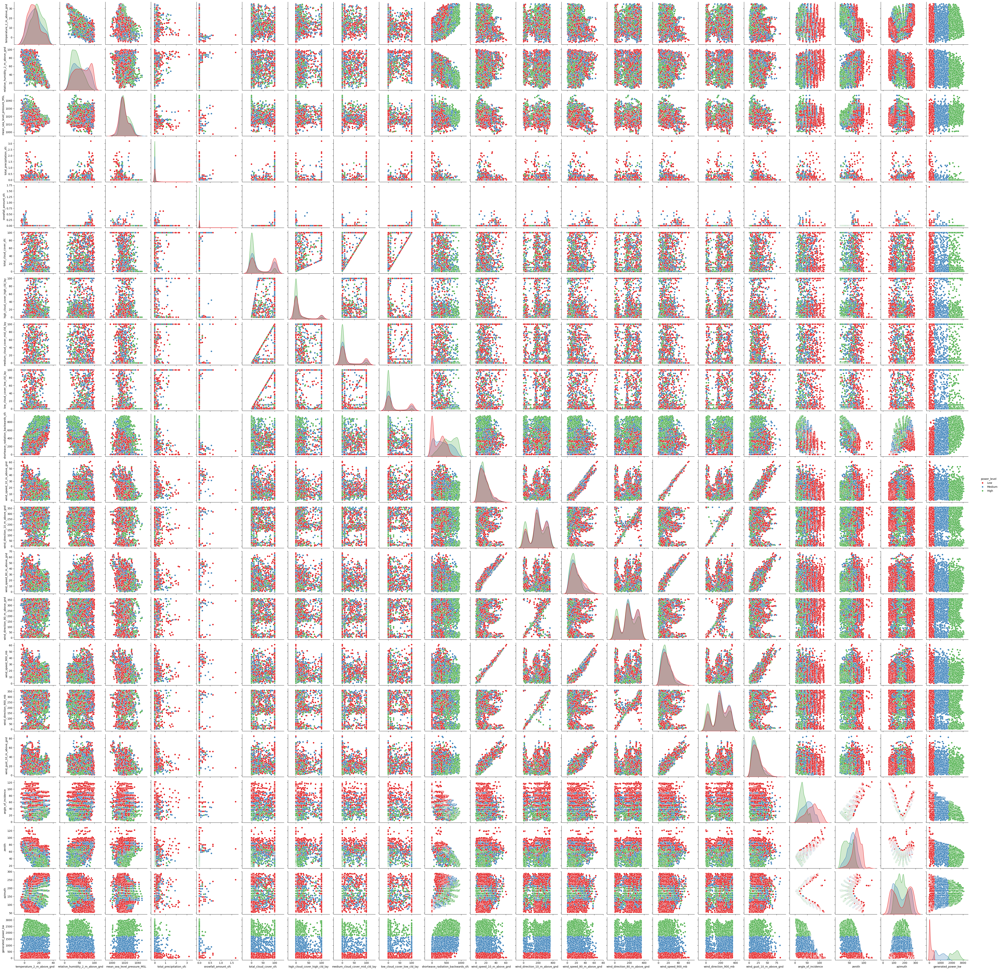

In [34]:
df['power_level'] = pd.qcut(df['generated_power_kw'], q=3, labels=["Low", "Medium", "High"])
sns.pairplot(df , hue='power_level', palette='Set1', diag_kind='kde')
plt.show()

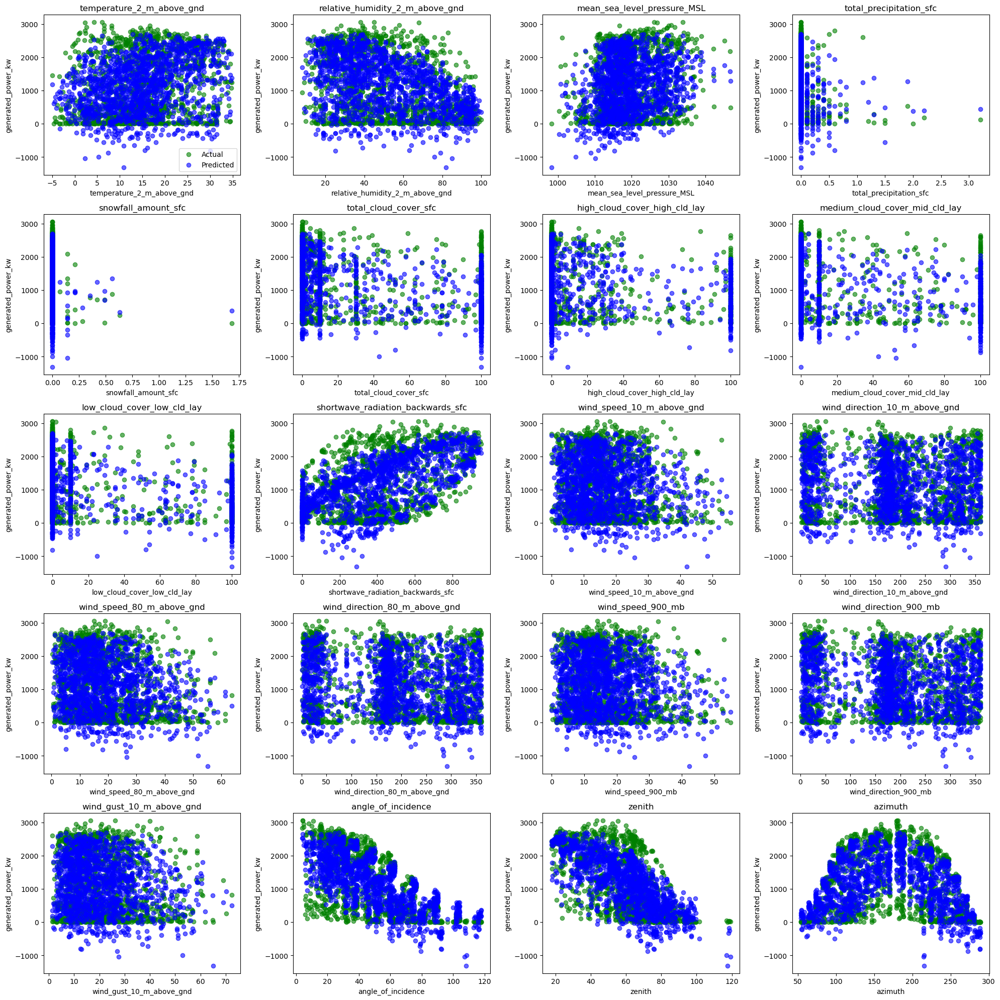

In [35]:
feature_names = ['temperature_2_m_above_gnd', 'relative_humidity_2_m_above_gnd',
       'mean_sea_level_pressure_MSL', 'total_precipitation_sfc',
       'snowfall_amount_sfc', 'total_cloud_cover_sfc',
       'high_cloud_cover_high_cld_lay', 'medium_cloud_cover_mid_cld_lay',
       'low_cloud_cover_low_cld_lay', 'shortwave_radiation_backwards_sfc',
       'wind_speed_10_m_above_gnd', 'wind_direction_10_m_above_gnd',
       'wind_speed_80_m_above_gnd', 'wind_direction_80_m_above_gnd',
       'wind_speed_900_mb', 'wind_direction_900_mb',
       'wind_gust_10_m_above_gnd', 'angle_of_incidence', 'zenith', 'azimuth']

y_pred = y_pred.ravel()

# Create a grid for subplots (5 rows × 4 columns for 20 features)
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 20))
axes = axes.flatten()  # Flatten 2D axes array to 1D for easy indexing

for i in range(x_test.shape[1]):
    ax = axes[i]
    ax.scatter(x_test.iloc[:, i], y_test, color='green', alpha=0.6, label='Actual')
    ax.scatter(x_test.iloc[:, i], y_pred, color='blue', alpha=0.6, label='Predicted')
    
    ax.set_xlabel(feature_names[i], fontsize=10)
    ax.set_ylabel('generated_power_kw', fontsize=10)
    ax.set_title(feature_names[i], fontsize=12)
    
    # Show legend only in the first subplot
    if i == 0:
        ax.legend()

# Hide any unused subplots if feature count < 20
for j in range(x_test.shape[1], len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

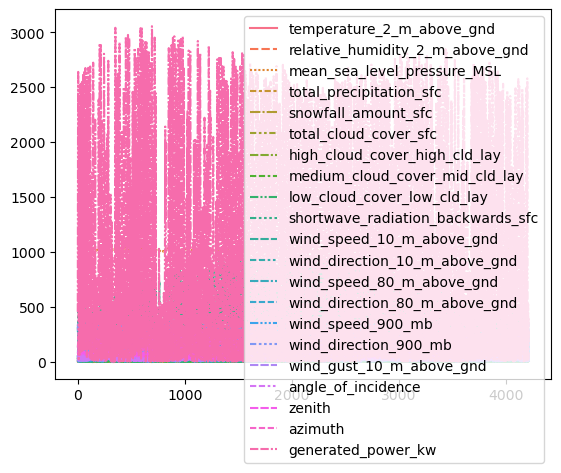

In [11]:
sns.lineplot(df)
plt.show()

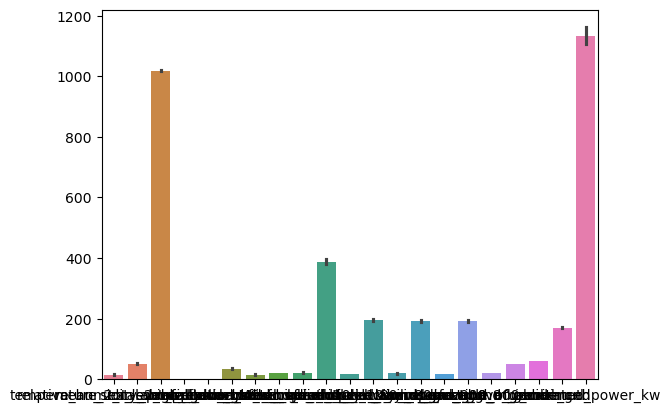

In [30]:
sns.barplot(df)
plt.show()

In [12]:
model = linear_model.LinearRegression()

In [13]:
df.columns

Index(['temperature_2_m_above_gnd', 'relative_humidity_2_m_above_gnd',
       'mean_sea_level_pressure_MSL', 'total_precipitation_sfc',
       'snowfall_amount_sfc', 'total_cloud_cover_sfc',
       'high_cloud_cover_high_cld_lay', 'medium_cloud_cover_mid_cld_lay',
       'low_cloud_cover_low_cld_lay', 'shortwave_radiation_backwards_sfc',
       'wind_speed_10_m_above_gnd', 'wind_direction_10_m_above_gnd',
       'wind_speed_80_m_above_gnd', 'wind_direction_80_m_above_gnd',
       'wind_speed_900_mb', 'wind_direction_900_mb',
       'wind_gust_10_m_above_gnd', 'angle_of_incidence', 'zenith', 'azimuth',
       'generated_power_kw'],
      dtype='object')

In [14]:
df_x = df[['temperature_2_m_above_gnd', 'relative_humidity_2_m_above_gnd',
       'mean_sea_level_pressure_MSL', 'total_precipitation_sfc',
       'snowfall_amount_sfc', 'total_cloud_cover_sfc',
       'high_cloud_cover_high_cld_lay', 'medium_cloud_cover_mid_cld_lay',
       'low_cloud_cover_low_cld_lay', 'shortwave_radiation_backwards_sfc',
       'wind_speed_10_m_above_gnd', 'wind_direction_10_m_above_gnd',
       'wind_speed_80_m_above_gnd', 'wind_direction_80_m_above_gnd',
       'wind_speed_900_mb', 'wind_direction_900_mb',
       'wind_gust_10_m_above_gnd', 'angle_of_incidence', 'zenith', 'azimuth']]
df_y = df["generated_power_kw"]

In [15]:
df_x

,temperature_2_m_above_gnd,relative_humidity_2_m_above_gnd,mean_sea_level_pressure_MSL,total_precipitation_sfc,snowfall_amount_sfc,total_cloud_cover_sfc,high_cloud_cover_high_cld_lay,medium_cloud_cover_mid_cld_lay,low_cloud_cover_low_cld_lay,shortwave_radiation_backwards_sfc,wind_speed_10_m_above_gnd,wind_direction_10_m_above_gnd,wind_speed_80_m_above_gnd,wind_direction_80_m_above_gnd,wind_speed_900_mb,wind_direction_900_mb,wind_gust_10_m_above_gnd,angle_of_incidence,zenith,azimuth
0,2.17,31,1035.0,0.0,0.0,0.0,0,0,0,0.00,6.37,312.71,9.36,22.62,6.62,337.62,24.48,58.753108,83.237322,128.33543
1,2.31,27,1035.1,0.0,0.0,0.0,0,0,0,1.78,5.15,294.78,5.99,32.74,4.61,321.34,21.96,45.408585,75.143041,139.65530
2,3.65,33,1035.4,0.0,0.0,0.0,0,0,0,108.58,4.68,270.00,3.89,56.31,3.76,286.70,14.04,32.848282,68.820648,152.53769
3,5.82,30,1035.4,0.0,0.0,0.0,0,0,0,258.10,3.60,323.13,3.55,23.96,3.08,339.44,19.80,22.699288,64.883536,166.90159
4,7.73,27,1034.4,0.0,0.0,0.0,0,0,0,375.58,6.21,10.01,6.76,25.20,6.62,22.38,16.56,19.199908,63.795208,182.13526
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4208,8.69,66,1025.1,0.0,0.0,100.0,100,100,100,257.21,21.66,285.42,25.50,283.06,24.01,282.99,25.20,22.700907,64.952098,167.06794
4209,7.57,90,1026.1,0.0,0.0,100.0,79,100,100,210.04,11.97,6.91,13.00,4.76,11.61,7.13,10.44,19.307487,63.895118,182.28247
4210,7.27,90,1026.3,0.1,0.0,100.0,73,100,100,113.92,9.01,2.29,8.71,352.87,7.95,354.81,22.32,25.249506,65.827032,197.33868
4211,8.25,81,1025.5,0.0,0.0,100.0,74,66,100,186.90,7.34,11.31,6.29,13.24,5.94,14.04,15.48,36.361161,70.496313,211.30027


In [16]:
df_y

0        454.100950
1       1411.999400
2       2214.849300
3       2527.609200
4       2640.203400
           ...     
4208     173.410560
4209     403.792220
4210     158.367780
4211     126.953060
4212      20.055031
Name: generated_power_kw, Length: 4213, dtype: float64

In [17]:
x_train , x_test , y_train , y_test = train_test_split(df_x , df_y , test_size = 0.33 , random_state = 42)

In [18]:
model.fit(x_train , y_train)

LinearRegression()

In [19]:
print(model.coef_)

[-9.26361905e+00 -4.49567038e+00  1.59599520e+01  2.22624886e+01
  5.21869683e+02 -1.65639541e+00 -8.54051559e-01 -1.32334689e+00
 -1.32182002e+00  1.26742845e+00  1.60377550e+01  1.18014788e-01
  9.29484367e+00  1.15166382e-01 -3.00652964e+01 -7.21106359e-04
 -3.07560996e+00 -1.53725956e+01 -6.91488761e+00 -6.25721963e+00]


In [21]:
y_pred = model.predict(x_test)
print(y_pred)

[2031.16459382  422.12770337 1619.10963598 ...  258.39236889 2042.94595108
 1872.45056765]


In [22]:
mean_squared_error(y_test , y_pred)

270386.1345919874

In [23]:
r2_score(y_test , y_pred) * 100

69.0300830643928

In [25]:
joblib.dump(model , "Models/Power_Generation_Linear_regression.pkl")

['Models/Power_Generation_Linear_regression.pkl']

In [26]:
Model = joblib.load("Models/Linear_regression.pkl")

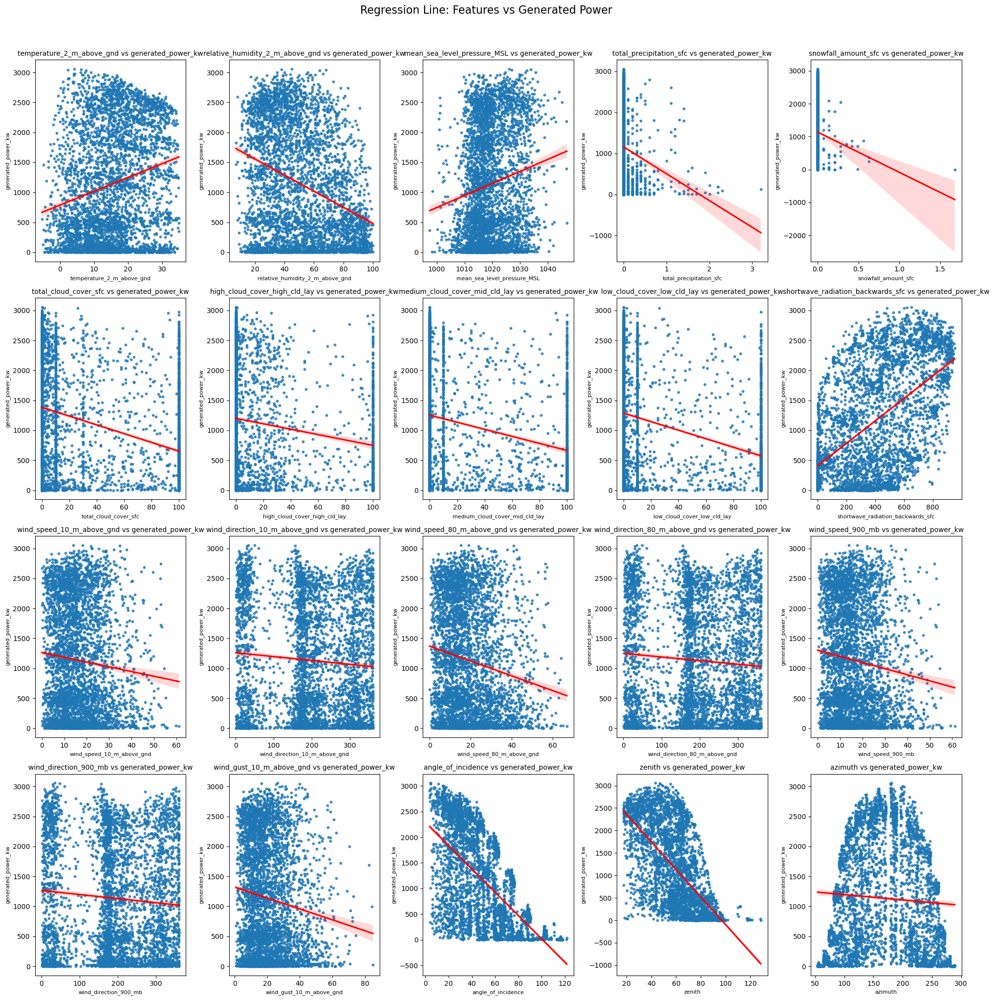

In [28]:

features = [
    'temperature_2_m_above_gnd', 'relative_humidity_2_m_above_gnd',
    'mean_sea_level_pressure_MSL', 'total_precipitation_sfc',
    'snowfall_amount_sfc', 'total_cloud_cover_sfc',
    'high_cloud_cover_high_cld_lay', 'medium_cloud_cover_mid_cld_lay',
    'low_cloud_cover_low_cld_lay', 'shortwave_radiation_backwards_sfc',
    'wind_speed_10_m_above_gnd', 'wind_direction_10_m_above_gnd',
    'wind_speed_80_m_above_gnd', 'wind_direction_80_m_above_gnd',
    'wind_speed_900_mb', 'wind_direction_900_mb',
    'wind_gust_10_m_above_gnd', 'angle_of_incidence', 'zenith', 'azimuth'
]

target = 'generated_power_kw'

plt.figure(figsize=(20, 20))
for i, feature in enumerate(features):
    plt.subplot(4, 5, i + 1)
    sns.regplot(data=df, x=feature, y=target, scatter_kws={'s': 10}, line_kws={"color": "red"})
    plt.xlabel(feature, fontsize=8)
    plt.ylabel(target, fontsize=8)
    plt.title(f"{feature} vs {target}", fontsize=10)
    plt.tight_layout()

plt.suptitle("Regression Line: Features vs Generated Power", fontsize=16, y=1.02)
plt.tight_layout()
plt.show()
